In [1]:
import pickle
import os
import random
from utils import *
from PIL import ImageOps, Image
from torchvision import transforms
from matplotlib import pyplot as plt
from wordcloud import WordCloud
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from eval import *

# words to ignore in wordclouds
stopwords = set(stopwords.words('english'))

# image resizing for display
tfs = transforms.Compose([transforms.Resize(256), transforms.CenterCrop(256)])

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/s2478846/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


You must run ```test.py``` for the selected model before using this notebook.

In [2]:
# Update with your paths and model names
DATASET_PATH = '/data/s2478846/data'
SAVE_PATH = '/data/s2478846/cross_modal_retrieval/dual_stream/model'
MODEL_NAME = 'htrans_vit_v2'
SPLIT = 'test'
EMBEDDINGS_FILE = os.path.join(SAVE_PATH, MODEL_NAME, 'feats_' + SPLIT + '.pkl')

In [3]:
# load dataset (for display purposes)
dataset = pickle.load(open(os.path.join(DATASET_PATH, 'traindata', SPLIT + '.pkl'), 'rb'))

In [4]:
def load_data_single(path):
    with open(path, 'rb') as f:
        imfeats = pickle.load(f)
        recipefeats = pickle.load(f)
        ids = pickle.load(f)
    return {'imfeats': imfeats, 'recipefeats': recipefeats, 'ids': ids}
# load embeddings
info = load_data_single(EMBEDDINGS_FILE)

In [5]:
# pick random sample
k = 1000
sub_ids = random.sample(range(0, len(info['imfeats'])), k)

In [6]:
# Compute rankings and store results for all selected samples

max_k = 10

queries = info['imfeats'][sub_ids,:]
database = info['recipefeats'][sub_ids,:]
ids = np.array(list(info['ids']))[sub_ids]
    
dists = pairwise_distances(queries, database, metric='cosine')
retrieved_idxs_recs = np.argpartition(dists, range(max_k), axis=-1)[:, :max_k]
    
dists = pairwise_distances(database, queries, metric='cosine')
retrieved_idxs_ims = np.argpartition(dists, range(max_k), axis=-1)[:, :max_k]
        
metrics_glob_rec, metrics_dict_ind_rec = compute_metrics(queries, database, metric='cosine',
                                                         recall_klist=(1, 5, 10), return_raw=True)
print("img2rec", metrics_glob_rec)
metrics_glob_img, metrics_dict_ind_img = compute_metrics(database, queries, metric='cosine',
                                                             recall_klist=(1, 5, 10), return_raw=True)
print("rec2im", metrics_glob_img)

ind_medr_rec = metrics_dict_ind_rec['medr']
ind_medr_img = metrics_dict_ind_img['medr']
ranks = ind_medr_rec
    
display_results = {}
for i, recipe_id in enumerate(ids):
        
    retrieved_recipes = [ids[idx] for idx in retrieved_idxs_recs[i]]
    retrieved_images = [ids[idx] for idx in retrieved_idxs_ims[i]]
        
    display_results[recipe_id] = {'true_recipe_id': recipe_id,
                                  'retrieved_recipe_ids': retrieved_recipes,
                                  'retrieved_image_ids': retrieved_images,
                                  'rank_true_recipe': ind_medr_rec[i],
                                  'rank_true_image': ind_medr_img[i]}

img2rec {'medr': 1.0, 'recall_1': 0.503, 'recall_5': 0.816, 'recall_10': 0.893}
rec2im {'medr': 2.0, 'recall_1': 0.499, 'recall_5': 0.82, 'recall_10': 0.883}


In [8]:
display_results['3dea1d62bc']

{'true_recipe_id': '3dea1d62bc',
 'retrieved_recipe_ids': ['3dea1d62bc',
  '7ffc3ce307',
  '3b401667f5',
  '22df25b9dd',
  'a967dd2ac7',
  '5d551ade01',
  'cb3d9d1789',
  '725d0b253d',
  '59c64b0c16',
  '4e4bfd78d5'],
 'retrieved_image_ids': ['3dea1d62bc',
  'cb3d9d1789',
  '131719b31d',
  '26d202b0b5',
  '59c64b0c16',
  'c2a573e7b8',
  '4e4bfd78d5',
  'a967dd2ac7',
  '791d43e892',
  '3f3fb55c23'],
 'rank_true_recipe': 1,
 'rank_true_image': 1}

Note that the above retrieval metrics will differ from those obtained when running eval.py on the same embeddings. In this case, metrics are computed on a single random sample of 10k.

In [7]:
# display utilities

def load_image(image_path):
    return tfs(Image.open(image_path).convert('RGB'))

def plot_image(dataset_sample):
    plt.imshow(get_image(dataset_sample))
    plt.axis('off')
    plt.show()

def get_image(dataset_sample):
    img_name = dataset_sample['images'][0]
    img_name = '/'.join(img_name[:4])+'/'+img_name
    return load_image(os.path.join('/data/s2478846/data', 'test', img_name))

def get_wordcloud(dataset_sample):
    recipe_text = ''
    recipe_text+=dataset_sample['title'].lower()
    recipe_text+='\n'.join(dataset_sample['ingredients']).lower()
    recipe_text+='\n'.join(dataset_sample['instructions']).lower()
    # print(recipe_text)
    wordcloud = WordCloud(width=256, random_state = 1234, stopwords=stopwords, 
               height=256, background_color="white").generate(recipe_text)
    # print('test')
    return Image.fromarray(wordcloud.to_array())
    # return plt.imshow(wordcloud)

def plot_ranking(query, elements, dataset, rank, mode = 'im2recipe'):
    height = 20
    N = len(elements) + 1
    fig, ax = plt.subplots(1,N, figsize=(height*N,height), gridspec_kw = {'wspace':0, 'hspace':0})
    if mode == 'im2recipe':
        img = get_image(dataset[query])
    else: 
        img = get_wordcloud(dataset[query])
    
    img_with_border = ImageOps.expand(img, border=10,fill='blue')
    ax[0].imshow(img_with_border)
    ax[0].axis('off')
    
    for i, element in enumerate(elements):
        if mode == 'recipe2im':
            img = get_image(dataset[element])
        else:
            img = get_wordcloud(dataset[element])
        if i+1 == rank:
            img = ImageOps.expand(img, border=10,fill='green')
        
        ax[i+1].imshow(img)
        ax[i+1].axis('off')
    plt.show()

recipe_id: fe726c5696
Image2Recipe, rank: 3



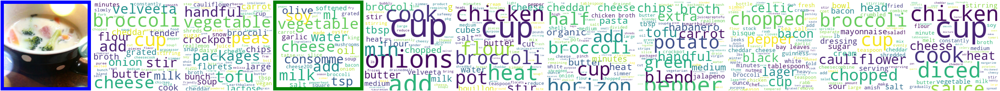

Recipe2Image, rank: 1


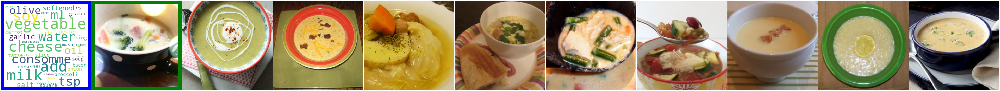

recipe_id: 8f165b6cbd
Image2Recipe, rank: 1



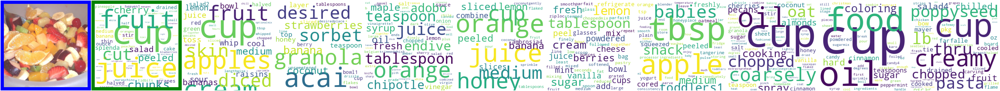

Recipe2Image, rank: 1


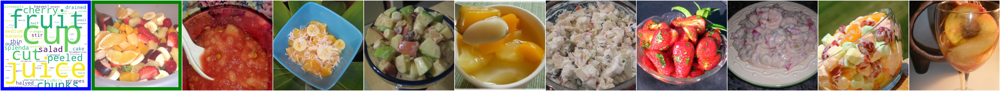

recipe_id: 25d9c6debd
Image2Recipe, rank: 4



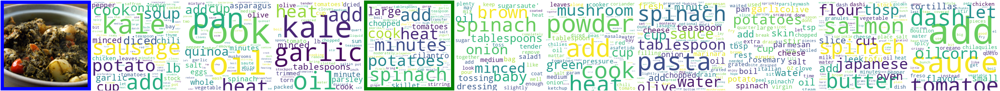

Recipe2Image, rank: 4


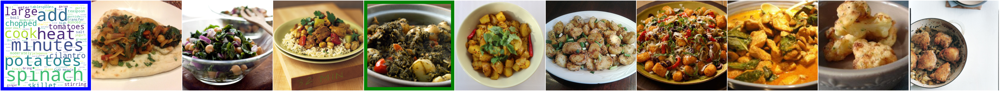

recipe_id: 028dea83c2
Image2Recipe, rank: 3



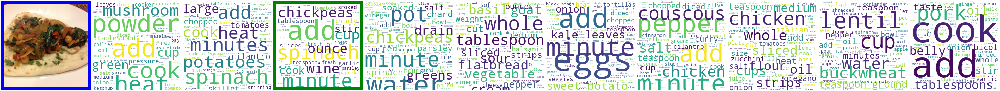

Recipe2Image, rank: 3


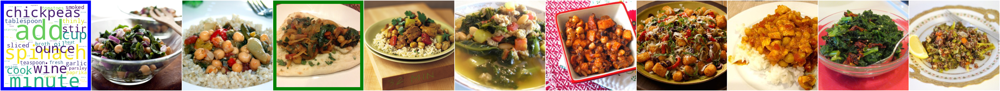

recipe_id: 1d2e1f10fc
Image2Recipe, rank: 1



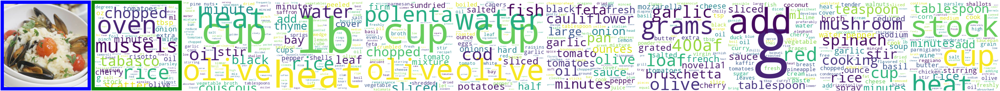

Recipe2Image, rank: 1


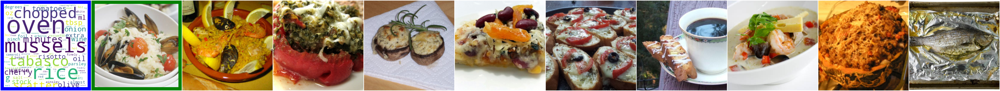

recipe_id: bd4a0dcb2e


In [8]:
# Display rankings

# min and max rank values to control which samples to display
min_rank = 0
max_rank = 1000

# ranking size
K = 10

# max number of samples to display ( -1 for all samples)
max_n_samples = 5
n = 0

for k, element in display_results.items():
    print('recipe_id:', k)
    if n == max_n_samples:
        break
    
    if max_rank > element['rank_true_recipe'] > min_rank:
        print("Image2Recipe, rank: {}\n".format(element['rank_true_recipe']))
        plot_ranking(element['true_recipe_id'], 
                     element['retrieved_recipe_ids'][0:K],
                     dataset,
                     element['rank_true_recipe'],
                     mode='im2recipe')
        
        print("Recipe2Image, rank: {}".format(element['rank_true_image']))
        plot_ranking(element['true_recipe_id'], 
                     element['retrieved_image_ids'][0:K],
                     dataset,
                     element['rank_true_image'],
                     mode='recipe2im')
        print("="*10)
        n += 1